In [1]:
# %matplotlib ipympl
# %matplotlib notebook
# %matplotlib qt
import pandas
import pathlib
import re
import numpy as np
# import plotly.graph_objects as go
import datetime
import matplotlib.pyplot as plt
from matplotlib import animation
import json
from typing import Tuple

cwd = pathlib.Path.cwd()

G = 6.67408e-11
YEARS = 1
SCALE = 100
SECONDS = 60*60*24/SCALE  # number of seconds in a day
yseconds = 365*SECONDS*SCALE  # number of seconds in a year
X = RN = 0  # I prefer doing this rather then using the numerical index
Y = VN = 1  # now I can plug these in and remind myself what this physically represents rather then remember which index I'm calling
dt = SECONDS
print(SECONDS)
print(yseconds)

864.0
31536000.0


In [2]:
def import_bodies() -> tuple:
    '''
    Reads the AstronomicalObjects.json and puts it in a vector.
    '''
    with open(cwd / "AstronomicalObjects.json", 'r') as json_file:
        json_data = json.load(json_file)
        system_data = json_data["System"]

        body_names = []
        mass = np.zeros((len(system_data), 1))
        rn = np.zeros((len(system_data), 1, 2))
        vn = np.zeros((len(system_data), 1, 2))

        for i, obj in enumerate(system_data.values()):
            body_names.append(obj["name"])
            mass[i] = obj["m"]
            
            rn[i][0][X] = obj["x0"]
            rn[i][0][Y] = obj["y0"]

            vn[i][0][X] = obj["vx0"]
            vn[i][0][Y] = obj["vy0"]

        return tuple(body_names), mass, rn, vn

        #     system.append(body)

        # return tuple(system)

In [3]:
def acc(rn: np.array, gm: np.array) -> np.array:
    '''
    rn is a Nx2 vector, and gm is a Nx1 vector. Note: gm should be mass * G * (-1)
    Yields the dv/dt = k value

    dv/dt = -G Sum[ Mj * (ri + (dri*h) - rj)/(ri + (dri*h) - rj)**3]
    '''

    an = np.zeros(shape = (rn.shape[0], 2))

    for i, ri in enumerate(rn):

        for j, rj in enumerate(rn):
            if j != i:

                r = np.sqrt(np.dot(ri - rj, ri - rj))

                a = gm[j] / r**3

                an[i] += a * (ri - rj)

    # print(an)
    # print(an.shape)

    return an


def euc_dist(x: np.array):
    return np.sqrt(np.dot(x, x))


def RK4(mass: np.array, rn: np.array, vn: np.array, h: float):
    '''
    Takes an Nx2 matrix for position & velocity, and Nx1 matrix for mass
    '''
    dr1 = h*vn
    dv1 = h*acc(rn, mass)

    dr2 = h*(vn + dv1*h/2)
    dv2 = h*acc(rn + (dr1*h/2), mass)
    
    dr3 = h*(vn + dv2*h/2)
    dv3 = h*acc(rn + (dr2*h/2), mass)

    dr4 = h*(vn + dv3*h)
    dv4 = h*acc(rn + (dr3*h), mass)

    return (rn + (1/6)*(dr1 + 2*dr2 + 2*dr3 + dr4)), (vn + (1/6)*(dv1 + 2*dv2 + 2*dv3 + dv4))


def orbits(time_steps: int, 
           body_names: tuple, 
           mass: np.array, 
           rn_data: np.array, 
           vn_data: np.array, 
           h: float, 
           delta = 1.0e-2):
    '''
    '''
    rn = rn_data[:, 0, :]
    vn = vn_data[:, 0, :]

    n_bodies = len(body_names)
    sun_index = body_names.index("Sun")
    sun_array = np.zeros((2,))

    
    t = 0
    while t < time_steps:

        rho = 0
        safty = 0
        while rho < 1:
            dt = 2*h
            
            rn1, vn1 = RK4(mass, rn, vn, h)
            rn1[sun_index, :] = sun_array
            vn1[sun_index, :] = sun_array
            rn1, vn1 = RK4(mass, rn1, vn1, h)
            rn1[sun_index, :] = sun_array
            vn1[sun_index, :] = sun_array

            rn2, vn2 = RK4(mass, rn, vn, 2*h)
            rn2[sun_index, :] = sun_array
            vn2[sun_index, :] = sun_array

            diff = np.apply_along_axis(euc_dist, 1, rn1 - rn2)

            rho_mat = 1 * h * delta * np.ones_like(diff)
            rho_mat = np.divide(rho_mat, diff, out = (2**4) * np.ones_like(rho_mat), where = diff != 0)

            rho = np.min(rho_mat)
            h = min(h * rho**(1/4), 2*h)
            if safty > 100:
                print("Iterated into oblivion")
                raise
            safty += 1

        rn, vn = rn1, vn1

        rn_data = np.concatenate([rn_data, np.reshape(rn, (n_bodies, 1, 2))], axis = 1)
        vn_data = np.concatenate([vn_data, np.reshape(vn, (n_bodies, 1, 2))], axis = 1)
        t += dt

        print(t)
    
    return rn_data


In [4]:
body_names, mass, rn, vn = import_bodies()

mass = (-1) * G * mass

rn = orbits(yseconds, body_names, mass, rn, vn, dt)
# print(rn.shape)

# print(rn[1])

# print(rn[1])
# print(rn[1, :, X])


1.8930584018270795
3.7863590204033466
5.678816706933919
7.571366365114655
9.46403099414883
11.35683934657664
13.249827368599375
15.14304000160396
17.035360273751262
18.926860574307735
20.819741884847964
22.71282111363197
24.606147769326444
26.498646121020577
28.391246613316593
30.283974789121444
32.17686258143052
34.069949913303255
35.962074498459856
37.85420776892566
39.74675252905455
41.639411035232825
43.53221173359069
45.42519018719942
47.31839085835074
49.21186933811833
51.1046048166141
52.99750173810591
54.890600482711115
56.78274289132079
58.6748984412739
60.56707041803823
62.459262928520594
64.35301017290837
66.24616544815757
68.13839614206424
70.03109316176001
71.92394200580759
73.8169806474245
75.70902919346703
77.60259633617865
79.4954702980977
81.38854034026606
83.28185551131223
85.17547713809464
87.06843620092347
88.96161263085672
90.85387636299423
92.74618356967935
94.63900017149393
96.53070197330374
98.4238353478101
100.31603183873155
102.20825499235012
104.1005114748703

KeyboardInterrupt: 

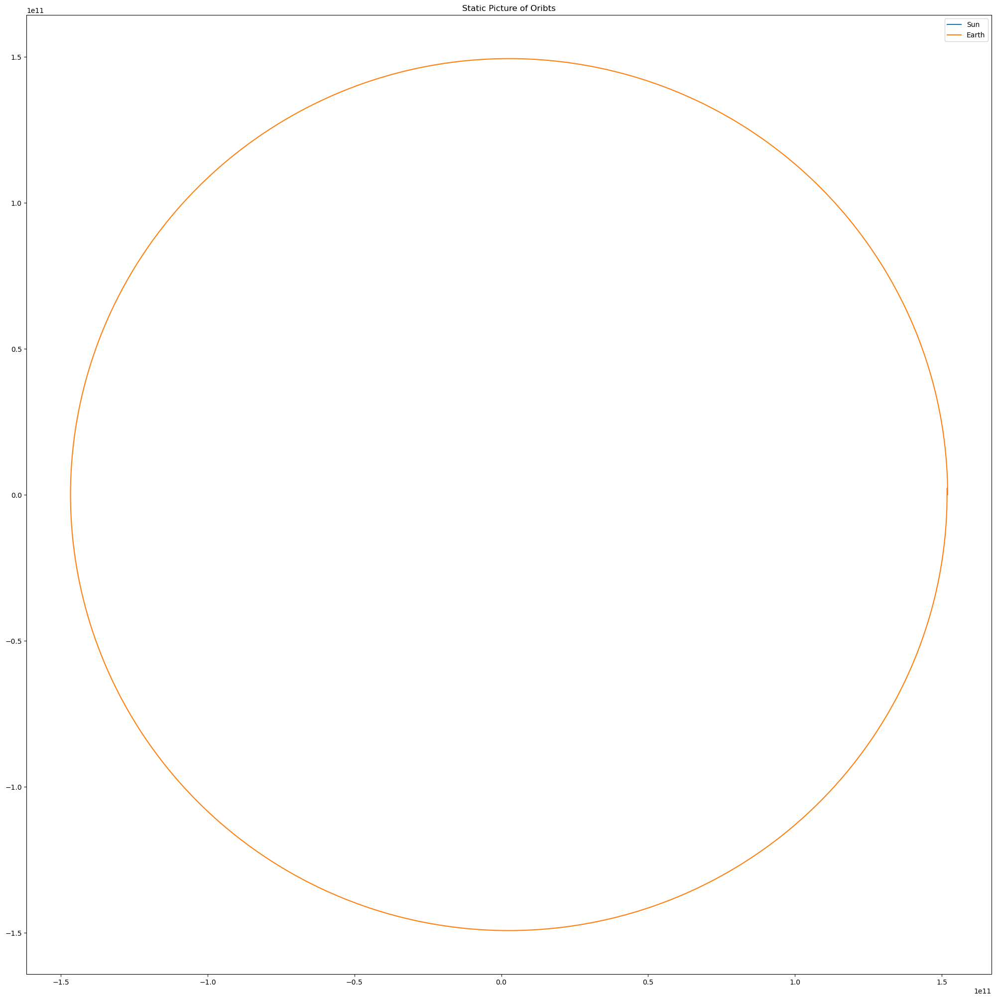

In [ ]:
plt.figure(figsize = (25, 25))

n_bodies = len(mass)

for body in range(n_bodies):
    x_data = rn[body, :, X]
    y_data = rn[body, :, Y]
    plt.plot(x_data, y_data, label = body_names[body])

plt.legend()
plt.title("Static Picture of Oribts")
plt.savefig(str(cwd / f"Static_Orbits_for_{YEARS}_years.png"))
plt.show()